In [1]:
from netCDF4 import Dataset
import numpy as np
import matplotlib.pyplot as plt

import pyproj

Comments!!!!!!
1) Remove comparison of subset
2) Make a separate function for calculataing speed out of disp

In [2]:
#nextsim output

%store -r xx_n
%store -r yy_n
%store -r cum_dx_n
%store -r cum_dy_n 

%store -r xx_n_subset
%store -r yy_n_subset
%store -r cum_dx_n_subset
%store -r cum_dy_n_subset 

#barents output

#Store variables
%store -r xx_b
%store -r yy_b
%store -r cum_dx_b
%store -r cum_dy_b 

%store -r xx_b_subset
%store -r yy_b_subset
%store -r cum_dx_b_subset
%store -r cum_dy_b_subset 

#full grid
%store -r X
%store -r Y
%store -r lon
%store -r lat
%store -r model_proj4

#subset grid
%store -r r
%store -r c
%store -r X_subset
%store -r Y_subset
%store -r lon_subset
%store -r lat_subset

%store -r time_diff_start
%store -r time_diff_end
%store -r total_time_diff
%store -r time_period_barents

# drift for the subset of overlap
%store -r upm
%store -r vpm
%store -r gpi
%store -r x1pm
%store -r y1pm

# drift for teh overlap for two original safe images
%store -r upm_large
%store -r vpm_large
%store -r apm_large
%store -r rpm_large
%store -r hpm_large
%store -r lon2pm_large
%store -r lat2pm_large
%store -r lon1pm_large
%store -r lat1pm_large
%store -r gpi_large

%store -r X_large_subset
%store -r Y_large_subset
%store -r lat_large_subset
%store -r lon_large_subset

In [3]:
#reshape for full grid
lists_to_reshape = [cum_dx_b, cum_dy_b, cum_dx_n, cum_dy_n]

for my_list in lists_to_reshape:
    for i, disp in enumerate(my_list):
        disp_reshaped = disp.reshape((lon.shape))
        my_list[i] = disp_reshaped


In [4]:
#reshape for subset grid
lists_to_reshape = [cum_dx_b_subset, cum_dy_b_subset, cum_dx_n_subset, cum_dy_n_subset]

for my_list in lists_to_reshape:
    for i, disp in enumerate(my_list):
        disp_reshaped = disp.reshape((lon_subset.shape))
        my_list[i] = disp_reshaped

In [5]:
# Iterate over each array in int_dx and int_dy lists
for i in range(len(cum_dx_n_subset)):
    cum_dx_n[i][np.isinf(cum_dx_n[i])] = np.nan
    cum_dy_n[i][np.isinf(cum_dy_n[i])] = np.nan
    cum_dx_b[i][np.isinf(cum_dx_b[i])] = np.nan
    cum_dy_b[i][np.isinf(cum_dy_b[i])] = np.nan
    cum_dx_n_subset[i][np.isinf(cum_dx_n_subset[i])] = np.nan
    cum_dy_n_subset[i][np.isinf(cum_dy_n_subset[i])] = np.nan
    cum_dx_b_subset[i][np.isinf(cum_dx_b_subset[i])] = np.nan
    cum_dy_b_subset[i][np.isinf(cum_dy_b_subset[i])] = np.nan


In [31]:
'''
#Calculate velocities if needed
# Divide values in the first list by 2272
cum_dx_b[0] /= (3600-time_diff_start)
cum_dy_b[0] /= (3600-time_diff_start)

# Divide values in the middle lists by 3600
for i in range(1, len(cum_dx_b)-1):
    cum_dx_b[i] /= ((3600-time_diff_start) + i*3600)
    cum_dy_b[i] /= ((3600-time_diff_start) + i*3600)

# Divide values in the last list by 179
cum_dx_b[-1] /= total_time_diff
cum_dy_b[-1] /= total_time_diff

cum_dx_n[0] /= (3600-time_diff_start)
cum_dy_n[0] /= (3600-time_diff_start)

# Divide values in the middle lists by 3600
for i in range(1, len(cum_dx_b)-1):
    cum_dx_n[i] /= ((3600-time_diff_start) + i*3600)
    cum_dy_n[i] /= ((3600-time_diff_start) + i*3600)

# Divide values in the last list by 179
cum_dx_n[-1] /= total_time_diff
cum_dy_n[-1] /= total_time_diff
'''

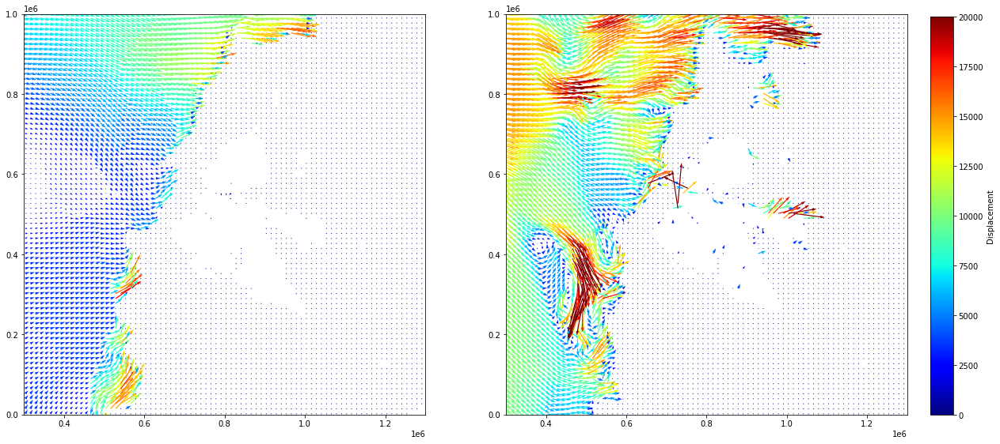

In [6]:
#Integrated drift for the full grid in meters
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(X[::step], Y[::step], cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step], np.hypot(cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 20000])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

quiver2 = axs[1].quiver(X[::step], Y[::step], cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step], np.hypot(cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3 , cmap='jet', clim=[0,20000])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

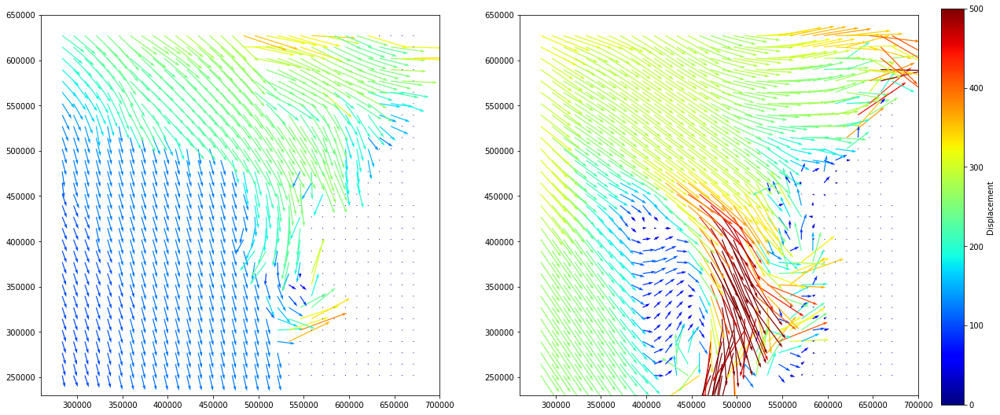

In [7]:
#Integrated drift for the subset grid in meters
step = 5




fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1= axs[0].quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step],
              np.hypot(cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.007, cmap='jet', clim=[0, 500])
axs[0].set_xlim([0.26e6, 0.7e6])
axs[0].set_ylim([0.23e6, 0.65e6])
axs[0].set_aspect('equal')
#quiver = plt.quiverkey(quiver1, 0.3e6, 0.3e6, 0.05, '0.05 m/s', coordinates='data')

axs[1].quiver(X_subset[::step], Y_subset[::step], cum_dx_b_subset[0][::step, ::step], cum_dy_b_subset[0][::step, ::step],
              np.hypot(cum_dx_b_subset[0][::step, ::step], cum_dy_b_subset[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.007 , cmap='jet', clim=[0,500])
axs[1].set_xlim([0.26e6, 0.7e6])
axs[1].set_ylim([0.23e6, 0.65e6])
axs[1].set_aspect('equal')



# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

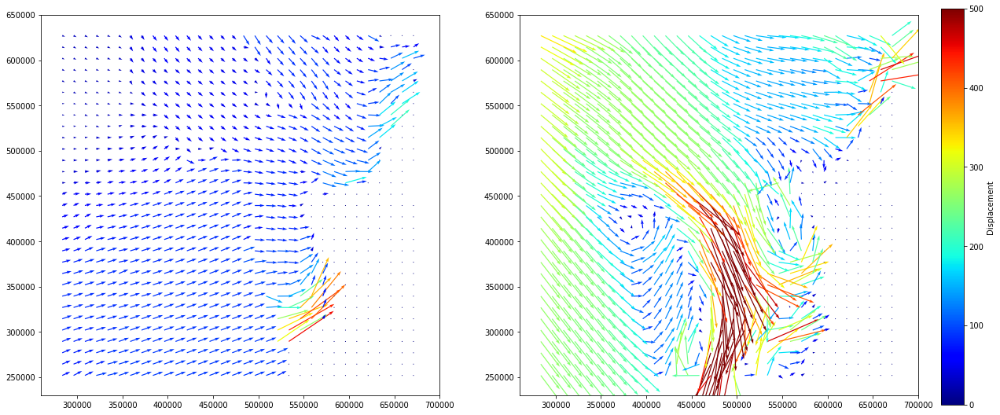

In [8]:
#Integrated drift for the subset grid in meters
step = 5




fig, axs = plt.subplots(1,2,figsize=(20,10))
axs[0].quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[-1][::step, ::step], cum_dy_n_subset[-1][::step, ::step],
              np.hypot(cum_dx_n_subset[-1][::step, ::step], cum_dy_n_subset[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 20000])
axs[0].set_xlim([0.26e6, 0.7e6])
axs[0].set_ylim([0.23e6, 0.65e6])
axs[0].set_aspect('equal')
#quiver = plt.quiverkey(quiver1, 0.3e6, 0.3e6, 0.05, '0.05 m/s', coordinates='data')

axs[1].quiver(X_subset[::step], Y_subset[::step], cum_dx_b_subset[-1][::step, ::step], cum_dy_b_subset[-1][::step, ::step],
              np.hypot(cum_dx_b_subset[-1][::step, ::step], cum_dy_b_subset[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3 , cmap='jet', clim=[0,20000])
axs[1].set_xlim([0.26e6, 0.7e6])
axs[1].set_ylim([0.23e6, 0.65e6])
axs[1].set_aspect('equal')



# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

In [9]:
step = 5
ar = np.zeros((len(X_subset)//step, len(Y_subset)//step))
ar.flatten().shape

(960,)

In [10]:
from matplotlib.animation import FuncAnimation

# Create the animation
fig, ax = plt.subplots()
quiver = ax.quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step], 
                   np.hypot(cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step]), 
                   angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 20000]) 

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label('Displacement')

# Store the quiver object in a list
quiver_list = [quiver]

def update(i):
    new_quiver = ax.quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[i][::step, ::step], cum_dy_n_subset[i][::step, ::step], 
                           np.hypot(cum_dx_n_subset[i][::step, ::step], cum_dy_n_subset[i][::step, ::step]), 
                           angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 20000]) 
    # Remove the previous quiver plot from the list
    old_quiver = quiver_list.pop(0)
    old_quiver.remove()
    # Append the new quiver object to the list
    quiver_list.append(new_quiver)
    return quiver_list

ani = FuncAnimation(fig, update, frames=len(cum_dx_n_subset), interval=250)

# Close the static plot
plt.close(fig)
# Display the animation in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


##### Animation within the subset for Nextsim and Barents models

In [11]:
from matplotlib.animation import FuncAnimation

# Create the animation
fig, axs = plt.subplots(1,2,figsize=(20,10))

quiver1 = axs[0].quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step],
                        np.hypot(cum_dx_n_subset[0][::step, ::step], cum_dy_n_subset[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.007, cmap='jet', clim=[0, 20000])
axs[0].set_xlim([0.26e6, 0.7e6])
axs[0].set_ylim([0.23e6, 0.65e6])
axs[0].set_aspect('equal')

quiver2 = axs[1].quiver(X_subset[::step], Y_subset[::step], cum_dx_b_subset[0][::step, ::step], cum_dy_b_subset[0][::step, ::step],
                        np.hypot(cum_dx_b_subset[0][::step, ::step], cum_dy_b_subset[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.007 , cmap='jet', clim=[0,20000])
axs[1].set_xlim([0.26e6, 0.7e6])
axs[1].set_ylim([0.23e6, 0.65e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label('Displacement')

# Store the quiver object in a list
quiver1_list = [quiver1]
quiver2_list = [quiver2]

def update(i):
    new_quiver1 = axs[0].quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[i][::step, ::step], cum_dy_n_subset[i][::step, ::step], 
                           np.hypot(cum_dx_n_subset[i][::step, ::step], cum_dy_n_subset[i][::step, ::step]), 
                           angles='xy', scale_units='xy', scale=0.2, cmap='jet', clim=[0, 20000])
    new_quiver2 = axs[1].quiver(X_subset[::step], Y_subset[::step], cum_dx_b_subset[i][::step, ::step], cum_dy_b_subset[i][::step, ::step], 
                           np.hypot(cum_dx_b_subset[i][::step, ::step], cum_dy_b_subset[i][::step, ::step]), 
                           angles='xy', scale_units='xy', scale=0.2, cmap='jet', clim=[0, 20000])
    # Remove the previous quiver plot from the list
    old_quiver1 = quiver1_list.pop(0)
    old_quiver1.remove()
    
    old_quiver2 = quiver2_list.pop(0)
    old_quiver2.remove()
    
    # Append the new quiver object to the list
    quiver1_list.append(new_quiver1)
    quiver2_list.append(new_quiver2)
    return quiver1_list, quiver2_list

ani = FuncAnimation(fig, update, frames=len(cum_dx_n_subset), interval=250)
# Close the static plot
plt.close(fig)
# Display the animation in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


##### Animation within the full grid for Nextsim and Barents models

In [12]:
from matplotlib.animation import FuncAnimation

# Create the animation
fig, axs = plt.subplots(1,2,figsize=(20,10))

quiver1 = axs[0].quiver(X[::step], Y[::step], cum_dx_n[0][::step, ::step], cum_dy_n[0][::step, ::step],
                        np.hypot(cum_dx_n[0][::step, ::step], cum_dy_n[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.2, cmap='jet', clim=[0, 20000])

axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

quiver2 = axs[1].quiver(X[::step], Y[::step], cum_dx_b[0][::step, ::step], cum_dy_b[0][::step, ::step],
                        np.hypot(cum_dx_b[0][::step, ::step], cum_dy_b[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.2 , cmap='jet', clim=[0,20000])

axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label('Displacement')

# Store the quiver object in a list
quiver1_list = [quiver1]
quiver2_list = [quiver2]

def update(i):
    new_quiver1 = axs[0].quiver(X[::step], Y[::step], cum_dx_n[i][::step, ::step], cum_dy_n[i][::step, ::step], 
                           np.hypot(cum_dx_n[i][::step, ::step], cum_dy_n[i][::step, ::step]), 
                           angles='xy', scale_units='xy', scale=0.2, cmap='jet', clim=[0, 20000])
    new_quiver2 = axs[1].quiver(X[::step], Y[::step], cum_dx_b[i][::step, ::step], cum_dy_b[i][::step, ::step], 
                           np.hypot(cum_dx_b[i][::step, ::step], cum_dy_b[i][::step, ::step]), 
                           angles='xy', scale_units='xy', scale=0.2, cmap='jet', clim=[0, 20000])
    # Remove the previous quiver plot from the list
    old_quiver1 = quiver1_list.pop(0)
    old_quiver1.remove()
    
    old_quiver2 = quiver2_list.pop(0)
    old_quiver2.remove()
    
    # Append the new quiver object to the list
    quiver1_list.append(new_quiver1)
    quiver2_list.append(new_quiver2)
    return quiver1_list, quiver2_list

ani = FuncAnimation(fig, update, frames=len(cum_dx_n_subset), interval=250)

# Close the static plot
plt.close(fig)

# Display the animation in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


In [13]:
sp = np.sqrt(upm**2 +vpm**2)

sar_mask = ~np.isnan(sp)
print(cum_dx_n_subset[0].flatten().shape)
print(cum_dx_n_subset[0][sar_mask].shape)


(24640,)
(10891,)


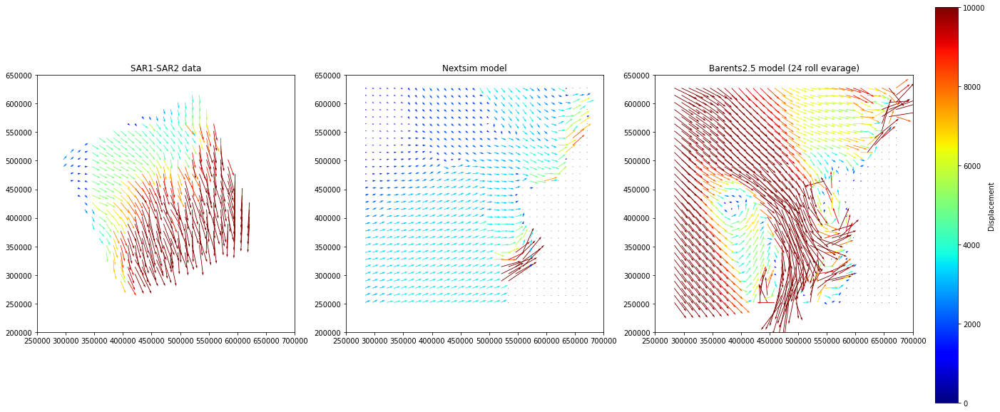

In [20]:
#Integrated drift

step = 5
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(22,11))
quiver1 = ax1.quiver(X_subset[::step], Y_subset[::step], upm[::step, ::step], vpm[::step, ::step], 
                        np.hypot(upm[::step, ::step], vpm[::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax1.set_xlim([0.25e6, 0.7e6]) 
ax1.set_ylim([0.2e6, 0.65e6]) 
ax1.set_aspect('equal')

quiver2 = ax2.quiver(X_subset[::step], Y_subset[::step], cum_dx_n_subset[-1][::step, ::step], cum_dy_n_subset[-1][::step, ::step],
                        np.hypot(cum_dx_n_subset[-1][::step, ::step], cum_dy_n_subset[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax2.set_xlim([0.25e6, 0.7e6]) 
ax2.set_ylim([0.2e6, 0.65e6]) 
ax2.set_aspect('equal')

quiver3 = ax3.quiver(X_subset[::step], Y_subset[::step], cum_dx_b_subset[-1][::step, ::step], cum_dy_b_subset[-1][::step, ::step],
                        np.hypot(cum_dx_b_subset[-1][::step, ::step], cum_dy_b_subset[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax3.set_xlim([0.25e6, 0.7e6]) 
ax3.set_ylim([0.2e6, 0.65e6]) 
ax3.set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

ax1.set_title("SAR1-SAR2 data")
ax2.set_title("Nextsim model")
ax3.set_title("Barents2.5 model (24 roll evarage)")

plt.show()

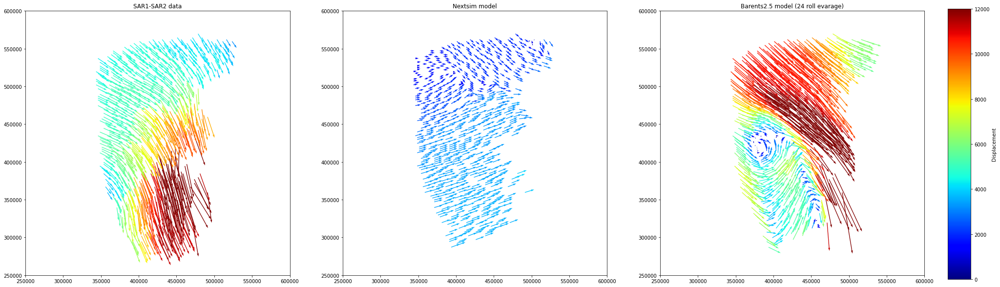

In [74]:
#Integrated drift
X_sub_mesh, Y_sub_mesh = np.meshgrid(X_subset, Y_subset)

step = 5
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(33,11))
quiver1 = ax1.quiver(X_sub_mesh[gpi][::step], Y_sub_mesh[gpi][::step], upm[gpi][::step], vpm[gpi][::step], 
                        np.hypot(upm[gpi][::step], vpm[gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 12000])
ax1.set_xlim([0.25e6, 0.6e6]) 
ax1.set_ylim([0.25e6, 0.6e6]) 
ax1.set_aspect('equal')

quiver2 = ax2.quiver(X_sub_mesh[sar_mask*gpi][::step], Y_sub_mesh[sar_mask*gpi][::step], cum_dx_n_subset[-1][sar_mask*gpi][::step], cum_dy_n_subset[-1][sar_mask*gpi][::step],
                        np.hypot(cum_dx_n_subset[-1][sar_mask*gpi][::step], cum_dy_n_subset[-1][sar_mask*gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 12000])
ax2.set_xlim([0.25e6, 0.6e6]) 
ax2.set_ylim([0.25e6, 0.6e6]) 
ax2.set_aspect('equal')

quiver2 = ax3.quiver(X_sub_mesh[sar_mask*gpi][::step], Y_sub_mesh[sar_mask*gpi][::step], cum_dx_b_subset[-1][sar_mask*gpi][::step], cum_dy_b_subset[-1][sar_mask*gpi][::step],
                        np.hypot(cum_dx_b_subset[-1][sar_mask*gpi][::step], cum_dy_b_subset[-1][sar_mask*gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 12000])
ax3.set_xlim([0.25e6, 0.6e6])
ax3.set_ylim([0.25e6, 0.6e6]) 

ax3.set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

ax1.set_title("SAR1-SAR2 data")
ax2.set_title("Nextsim model")
ax3.set_title("Barents2.5 model (24 roll evarage)")

plt.show()

In [103]:
X.shape, upm_large.shape

((739,), (301, 289))

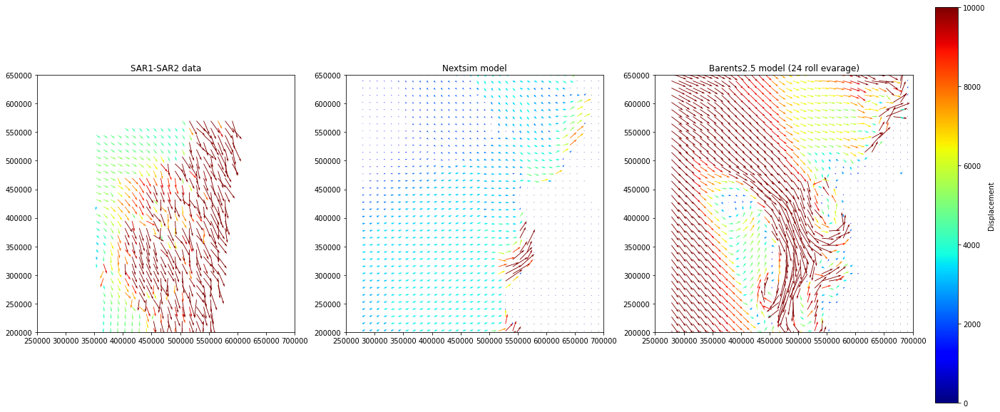

In [23]:
#Integrated drift

step = 5
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(22,11))
quiver1 = ax1.quiver(X_large_subset[::step], Y_large_subset[::step], upm_large[::step, ::step], vpm_large[::step, ::step], 
                        np.hypot(upm_large[::step, ::step], vpm_large[::step, ::step]), angles='xy', scale_units='xy', scale=0.5, cmap='jet', clim=[0, 10000])
ax1.set_xlim([0.3e6, 0.65e6]) 
ax1.set_ylim([0.1e6, 0.65e6])
ax1.set_xlim([0.25e6, 0.7e6]) 
ax1.set_ylim([0.2e6, 0.65e6]) 
ax1.set_aspect('equal')

quiver2 = ax2.quiver(X[::step], Y[::step], cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step],
                        np.hypot(cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.5, cmap='jet', clim=[0, 10000])
ax2.set_xlim([0.3e6, 0.65e6]) 
ax2.set_ylim([0.1e6, 0.65e6])
ax2.set_xlim([0.25e6, 0.7e6]) 
ax2.set_ylim([0.2e6, 0.65e6]) 
  
ax2.set_aspect('equal')

quiver2 = ax3.quiver(X[::step], Y[::step], cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step],
                        np.hypot(cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.5, cmap='jet', clim=[0, 10000])
ax3.set_xlim([0.3e6, 0.65e6]) 
ax3.set_ylim([0.1e6, 0.65e6])
ax3.set_xlim([0.25e6, 0.7e6]) 
ax3.set_ylim([0.2e6, 0.65e6]) 
 
ax3.set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

ax1.set_title("SAR1-SAR2 data")
ax2.set_title("Nextsim model")
ax3.set_title("Barents2.5 model (24 roll evarage)")

plt.show()

In [ ]:
#Integrated drift

step = 5
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(22,11))
quiver1 = ax1.quiver(X_large_subset[::step], Y_large_subset[::step], upm_large[::step, ::step], vpm_large[::step, ::step], 
                        np.hypot(upm_large[::step, ::step], vpm_large[::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax1.set_xlim([0.25e6, 0.7e6]) 
ax1.set_ylim([0.1e6, 0.65e6])
ax1.set_aspect('equal')

quiver2 = ax2.quiver(X[::step], Y[::step], cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step],
                        np.hypot(cum_dx_n[-1][::step, ::step], cum_dy_n[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax2.set_xlim([0.25e6, 0.7e6]) 
ax2.set_ylim([0.1e6, 0.65e6])
  
ax2.set_aspect('equal')

quiver2 = ax3.quiver(X[::step], Y[::step], cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step],
                        np.hypot(cum_dx_b[-1][::step, ::step], cum_dy_b[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
ax3.set_xlim([0.25e6, 0.7e6]) 
ax3.set_ylim([0.1e6, 0.65e6])
 
ax3.set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

ax1.set_title("SAR1-SAR2 data")
ax2.set_title("Nextsim model")
ax3.set_title("Barents2.5 model (24 roll evarage)")

plt.show()

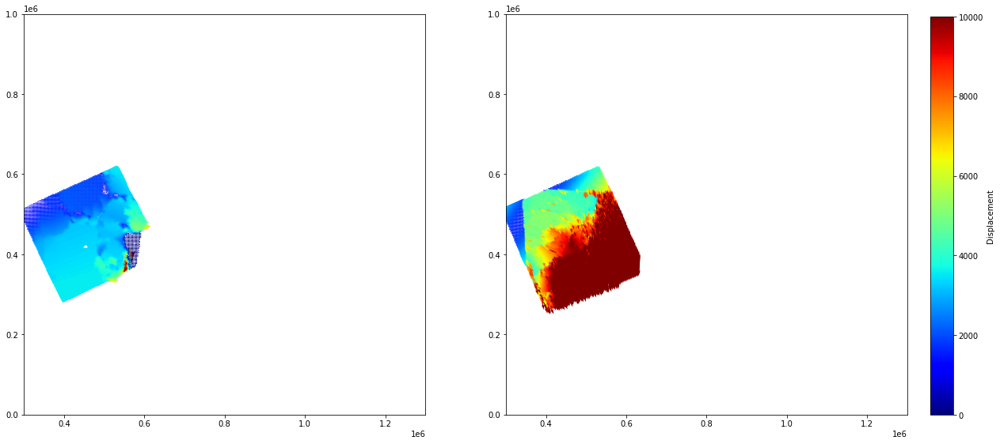

In [55]:
#Integrated drift
#Change fron ens 8 to 24 mean!
step = 1

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(X_sub_mesh[sar_mask][::step], Y_sub_mesh[sar_mask][::step], int_dx[-1][sar_mask][::step], int_dy[-1][sar_mask][::step], np.hypot(int_dx[-1][sar_mask][::step], int_dy[-1][sar_mask][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')
axs[1].quiver(X_subset[::step], Y_subset[::step], upm[::step, ::step], vpm[::step, ::step], np.hypot(upm[::step, ::step], vpm[::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

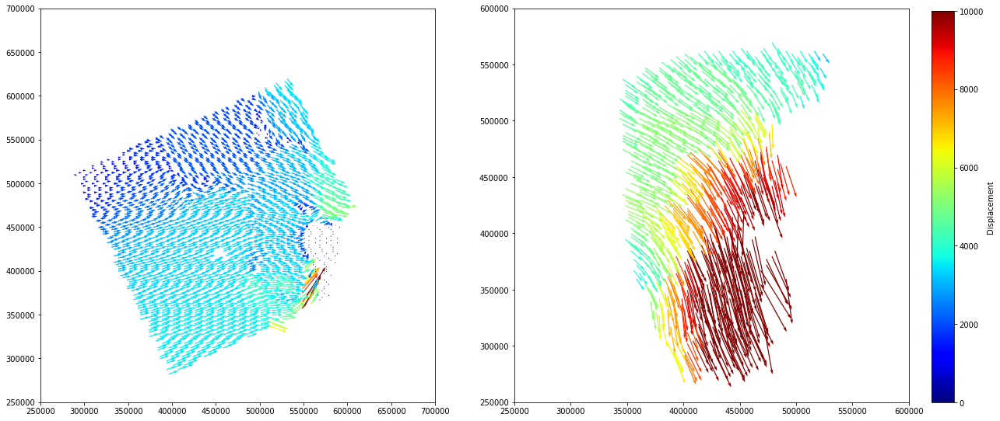

In [70]:
#Integrated drift
#Change fron ens 8 to 24 mean!
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(X_sub_mesh[sar_mask][::step], Y_sub_mesh[sar_mask][::step], int_dx[-1][sar_mask][::step], int_dy[-1][sar_mask][::step],
                        np.hypot(int_dx[-1][sar_mask][::step], int_dy[-1][sar_mask][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')
axs[1].quiver(X_sub_mesh[gpi][::step], Y_sub_mesh[gpi][::step], upm[gpi][::step], vpm[gpi][::step],
              np.hypot(upm[gpi][::step], vpm[gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Modify the limits for axs[1] (second subplot)
axs[0].set_xlim([0.25e6, 0.7e6]) 
axs[0].set_ylim([0.25e6, 0.7e6]) 
axs[0].set_aspect('equal')


axs[1].set_xlim([0.25e6, 0.6e6])  # Adjust the x-axis limits
axs[1].set_ylim([0.25e6, 0.6e6])  # Adjust the y-axis limits
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

NameError: name 'int_dx' is not defined

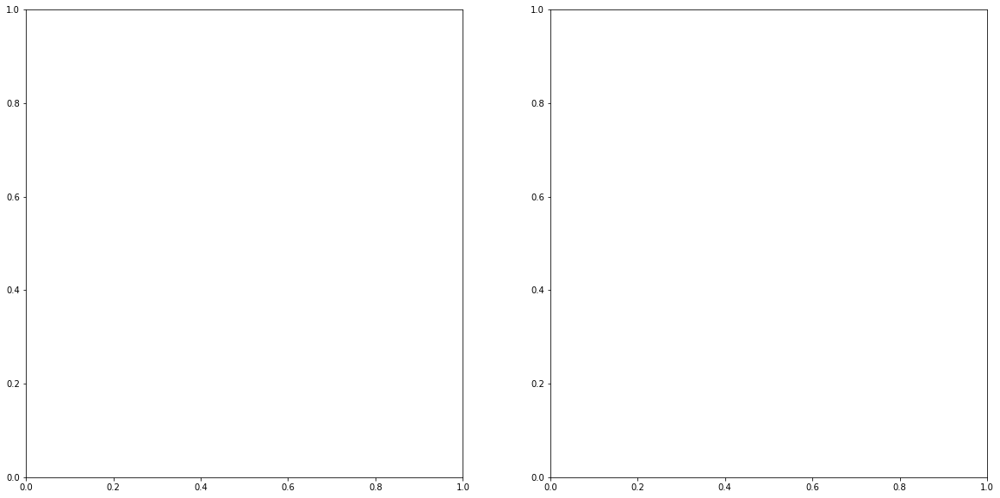

In [62]:
#Integrated drift
#Change fron ens 8 to 24 mean!
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(X_sub_mesh[sar_mask*gpi][::step], Y_sub_mesh[sar_mask*gpi][::step], int_dx[-1][sar_mask*gpi][::step], int_dy[-1][sar_mask*gpi][::step], np.hypot(int_dx[-1][sar_mask*gpi][::step], int_dy[-1][sar_mask*gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')
axs[1].quiver(X_sub_mesh[gpi][::step], Y_sub_mesh[gpi][::step], upm[gpi][::step], vpm[gpi][::step], np.hypot(upm[gpi][::step], vpm[gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Modify the limits for axs[1] (second subplot)
axs[0].set_xlim([0.25e6, 0.6e6])  # Adjust the x-axis limits
axs[0].set_ylim([0.25e6, 0.6e6])  # Adjust the y-axis limits
axs[0].set_aspect('equal')


axs[1].set_xlim([0.25e6, 0.6e6])  # Adjust the x-axis limits
axs[1].set_ylim([0.25e6, 0.6e6])  # Adjust the y-axis limits
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

In [42]:
X_sub_mesh, Y_sub_mesh = np.meshgrid(X_subset, Y_subset)

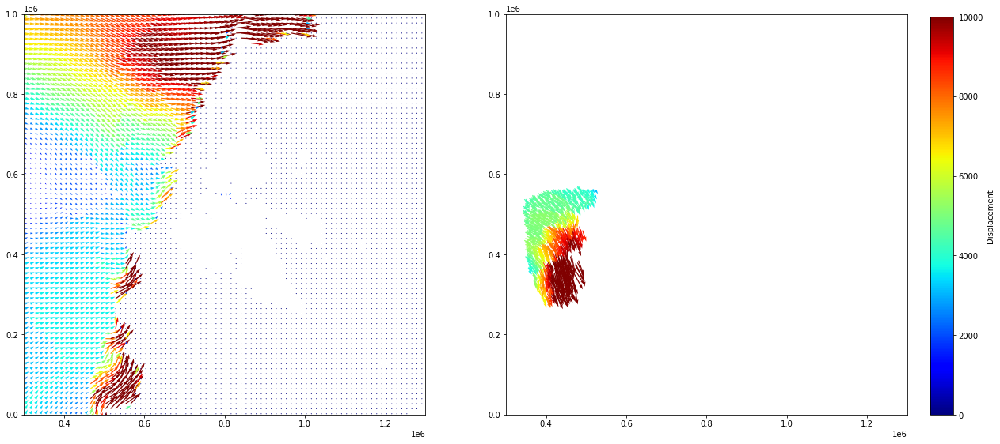

In [203]:
#Integrated drift
#Change fron ens 8 to 24 mean!
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(b_x[::step], b_y[::step], int_dx[-1][::step, ::step], int_dy[-1][::step, ::step], np.hypot(int_dx[-1][::step, ::step], int_dy[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')
axs[1].quiver(X_sub_mesh[gpi][::step], Y_sub_mesh[gpi][::step], upm[gpi][::step], vpm[gpi][::step], np.hypot(upm[gpi][::step], vpm[gpi][::step]), angles='xy', scale_units='xy', scale=0.3, cmap='jet', clim=[0, 10000])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

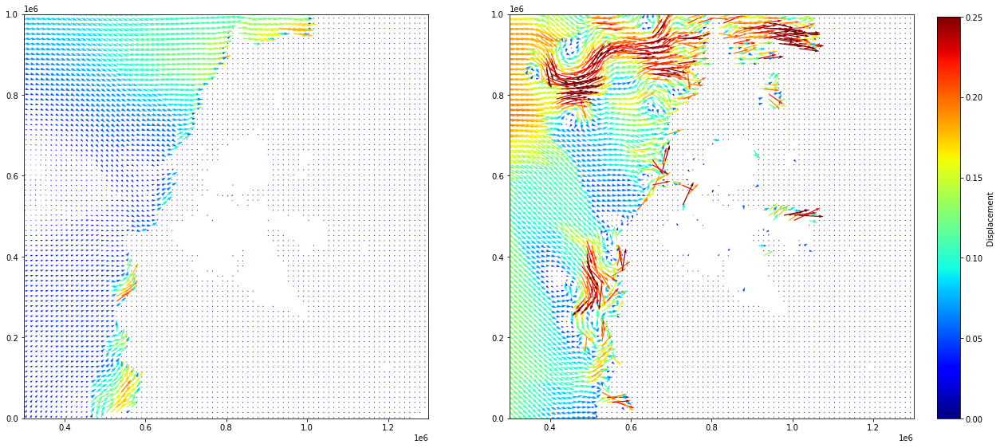

In [160]:
#Integrated drift
#Change fron ens 8 to 24 mean!
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
quiver1 = axs[0].quiver(b_x[::step], b_y[::step], int_dx[-1][::step, ::step], int_dy[-1][::step, ::step], np.hypot(int_dx[-1][::step, ::step], int_dy[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.25])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

axs[1].quiver(b_x[::step], b_y[::step], int_dx_b[-1][::step, ::step], int_dy_b[-1][::step, ::step], np.hypot(int_dx_b[-1][::step, ::step], int_dy_b[-1][::step, ::step]), angles='xy', scale_units='xy', scale=0.000005 , cmap='jet', clim=[0, 0.25])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

# Create a colorbar axis
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(quiver1, cax=cbar_ax)
cbar.set_label('Displacement')

plt.show()

NameError: name 'b_x' is not defined

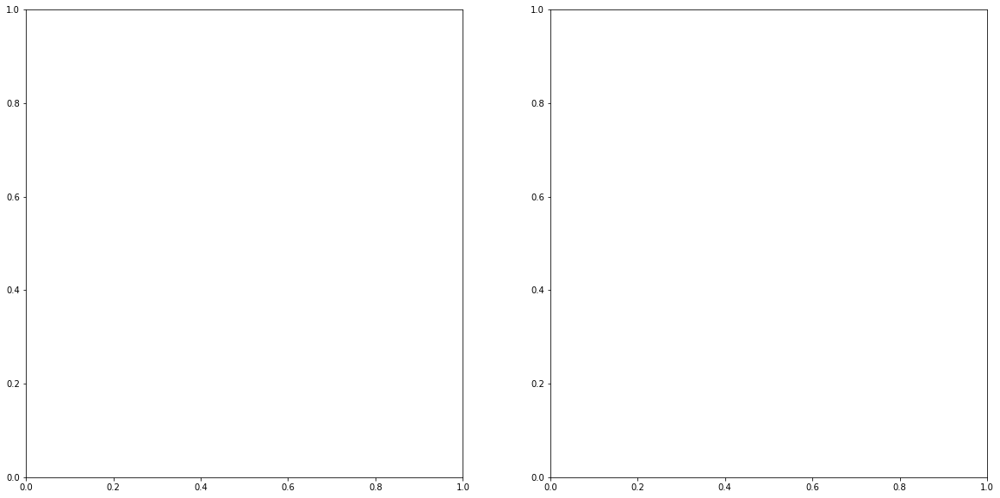

In [66]:
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
axs[0].quiver(b_x[::step], b_y[::step], ice_u_corrected[5][::step, ::step], ice_v_corrected[5][::step, ::step], np.hypot(ice_u_corrected[5][::step, ::step], ice_v_corrected[5][::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

axs[1].quiver(b_x[::step], b_y[::step], ice_u[::step, ::step], ice_v[::step, ::step], np.hypot(ice_u[::step, ::step], ice_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

plt.show()

ValueError: X and Y must be the same size, but X.size is 32 and Y.size is 31.

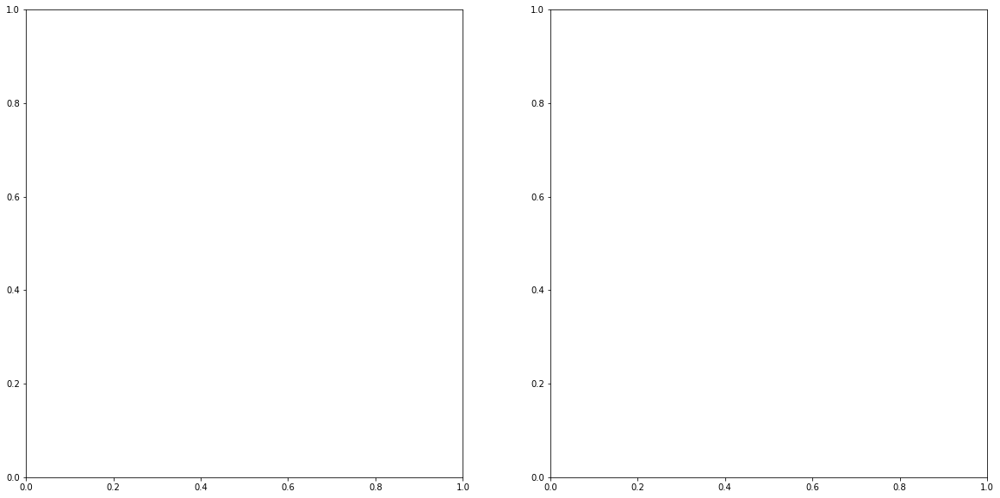

In [ ]:
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
axs[0].quiver(X_subset[::step], Y_subset[::step], ice_u_corrected[0][::step, ::step], ice_v_corrected[0][::step, ::step], np.hypot(ice_u_corrected[0][::step, ::step], ice_v_corrected[0][::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

axs[1].quiver(b_x[::step], b_y[::step], ice_u[::step, ::step], ice_v[::step, ::step], np.hypot(ice_u[::step, ::step], ice_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

plt.show()

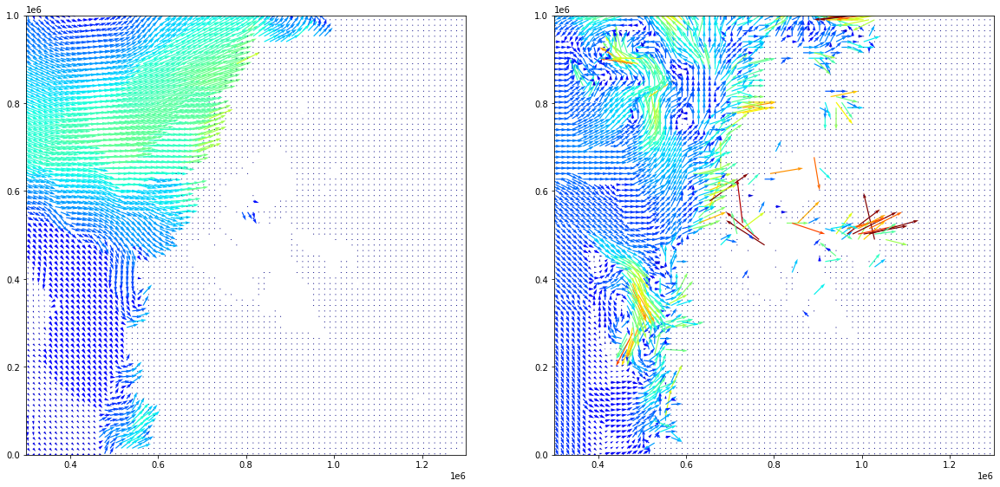

In [31]:
step = 5

fig, axs = plt.subplots(1,2,figsize=(20,10))
axs[0].quiver(b_x[::step], b_y[::step], b_u[::step, ::step], b_v[::step, ::step], np.hypot(b_u[::step, ::step], b_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[0].set_xlim([0.3e6,1.3e6])
axs[0].set_ylim([0,1e6])
axs[0].set_aspect('equal')

axs[1].quiver(b_x[::step], b_y[::step], ice_u[::step, ::step], ice_v[::step, ::step], np.hypot(ice_u[::step, ::step], ice_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000005, cmap='jet', clim=[0, 0.5])
axs[1].set_xlim([0.3e6,1.3e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

plt.show()

In [146]:
speed_model_b = np.sqrt((ice_u**2+ice_v**2)) 

speed_model_n = np.sqrt((ice_u_corrected[25].data**2+ice_v_corrected[25].data**2))

In [147]:
speed_model_b = speed_model_b.flatten()
speed_model_n = speed_model_n.flatten()
speed_model_b.shape,speed_model_n.shape 

((701311,), (701311,))

In [148]:
speed_model_n = speed_model_n[~np.isinf(speed_model_n)]

In [149]:
#speed_model_n = speed_model_n[~np.any(np.isinf(speed_model_n), axis=1), :]
speed_model_b.shape, speed_model_n.shape

((701311,), (461315,))

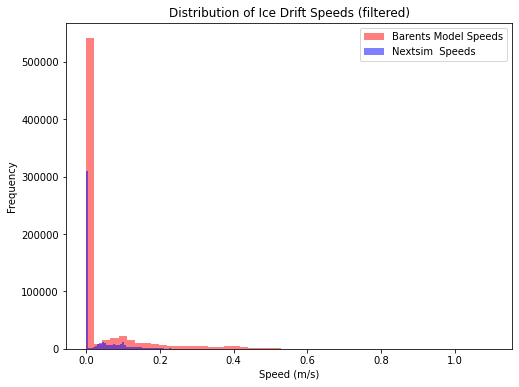

Reference Speeds:
Mean speed: 0.0493 m/s
Min speed: 0.0000 m/s
Max speed: 1.1003 m/s
95th percentile speed: 0.2772 m/s

Model Speeds:
Mean speed: 0.0493 m/s
Min speed: 0.0000 m/s
Max speed: 1.1003 m/s
95th percentile speed: 0.2772 m/s


In [150]:
plt.figure(figsize=(8,6))


# Plotting Model Speed
plt.hist(speed_model_b, bins=50, color='red', alpha=0.5, label= 'Barents Model Speeds')

# Plotting Reference Speed
plt.hist(speed_model_n, bins=50, color='blue', alpha=0.5, label='Nextsim  Speeds')

plt.xlabel('Speed (m/s)')
plt.ylabel('Frequency')
plt.title('Distribution of Ice Drift Speeds (filtered)')
plt.legend()
plt.show()

# Print statistics for reference speeds
percentile_95_ref = np.percentile(speed_model_b, 95)
mean_speed_ref = np.nanmean(speed_model_b)
min_speed_ref = np.nanmin(speed_model_b)
max_speed_ref = np.nanmax(speed_model_b)

print(f"Reference Speeds:")
print(f"Mean speed: {mean_speed_ref:.4f} m/s")
print(f"Min speed: {min_speed_ref:.4f} m/s")
print(f"Max speed: {max_speed_ref:.4f} m/s")
print(f"95th percentile speed: {percentile_95_ref:.4f} m/s")

# Print statistics for model speeds
percentile_95_model = np.percentile(speed_model_b, 95)
mean_speed_model = np.nanmean(speed_model_b)
min_speed_model = np.nanmin(speed_model_b)
max_speed_model = np.nanmax(speed_model_b)

print("\nModel Speeds:")
print(f"Mean speed: {mean_speed_model:.4f} m/s")
print(f"Min speed: {min_speed_model:.4f} m/s")
print(f"Max speed: {max_speed_model:.4f} m/s")
print(f"95th percentile speed: {percentile_95_model:.4f} m/s")


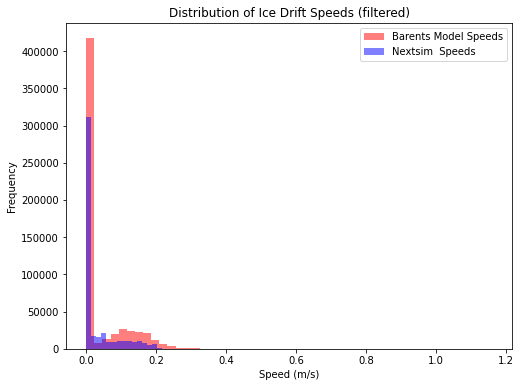

Reference Speeds:
Mean speed: 0.0373 m/s
Min speed: 0.0000 m/s
Max speed: 1.1602 m/s
95th percentile speed: nan m/s

Model Speeds:
Mean speed: 0.0373 m/s
Min speed: 0.0000 m/s
Max speed: 1.1602 m/s
95th percentile speed: nan m/s


In [163]:
speed_model_b = np.sqrt(( int_dx_b[-1]**2+ int_dy_b[-1]**2)) 
speed_model_n = np.sqrt((int_dx[-1]**2+int_dx[-1]**2))

speed_model_b = speed_model_b.flatten()
speed_model_n = speed_model_n.flatten()


plt.figure(figsize=(8,6))


# Plotting Model Speed
plt.hist(speed_model_b, bins=50, color='red', alpha=0.5, label= 'Barents Model Speeds')

# Plotting Reference Speed
plt.hist(speed_model_n, bins=50, color='blue', alpha=0.5, label='Nextsim  Speeds')

plt.xlabel('Speed (m/s)')
plt.ylabel('Frequency')
plt.title('Distribution of Ice Drift Speeds (filtered)')
plt.legend()
plt.show()

# Print statistics for reference speeds
percentile_95_ref = np.percentile(speed_model_b, 95)
mean_speed_ref = np.nanmean(speed_model_b)
min_speed_ref = np.nanmin(speed_model_b)
max_speed_ref = np.nanmax(speed_model_b)

print(f"Reference Speeds:")
print(f"Mean speed: {mean_speed_ref:.4f} m/s")
print(f"Min speed: {min_speed_ref:.4f} m/s")
print(f"Max speed: {max_speed_ref:.4f} m/s")
print(f"95th percentile speed: {percentile_95_ref:.4f} m/s")

# Print statistics for model speeds
percentile_95_model = np.percentile(speed_model_b, 95)
mean_speed_model = np.nanmean(speed_model_b)
min_speed_model = np.nanmin(speed_model_b)
max_speed_model = np.nanmax(speed_model_b)

print("\nModel Speeds:")
print(f"Mean speed: {mean_speed_model:.4f} m/s")
print(f"Min speed: {min_speed_model:.4f} m/s")
print(f"Max speed: {max_speed_model:.4f} m/s")
print(f"95th percentile speed: {percentile_95_model:.4f} m/s")


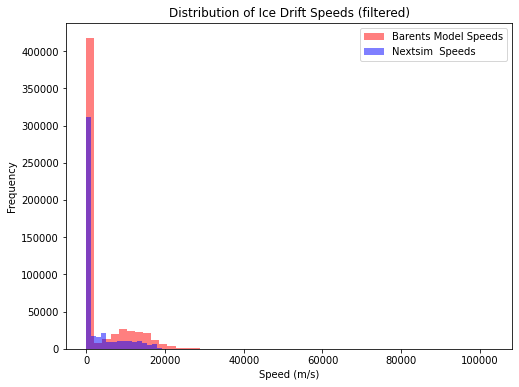

Reference Speeds:
Mean speed: 3310.8077 m/s
Min speed: 0.0000 m/s
Max speed: 103085.5450 m/s
95th percentile speed: nan m/s

Model Speeds:
Mean speed: 3310.8077 m/s
Min speed: 0.0000 m/s
Max speed: 103085.5450 m/s
95th percentile speed: nan m/s


In [169]:
speed_model_b = np.sqrt(( int_dx_b[-1]**2+ int_dy_b[-1]**2)) 
speed_model_n = np.sqrt((int_dx[-1]**2+int_dx[-1]**2))

speed_model_b = speed_model_b.flatten()
speed_model_n = speed_model_n.flatten()


plt.figure(figsize=(8,6))


# Plotting Model Speed
plt.hist(speed_model_b, bins=50, color='red', alpha=0.5, label= 'Barents Model Speeds')

# Plotting Reference Speed
plt.hist(speed_model_n, bins=50, color='blue', alpha=0.5, label='Nextsim  Speeds')

plt.xlabel('Speed (m/s)')
plt.ylabel('Frequency')
plt.title('Distribution of Ice Drift Speeds (filtered)')
plt.legend()
plt.show()

# Print statistics for reference speeds
percentile_95_ref = np.percentile(speed_model_b, 95)
mean_speed_ref = np.nanmean(speed_model_b)
min_speed_ref = np.nanmin(speed_model_b)
max_speed_ref = np.nanmax(speed_model_b)

print(f"Reference Speeds:")
print(f"Mean speed: {mean_speed_ref:.4f} m/s")
print(f"Min speed: {min_speed_ref:.4f} m/s")
print(f"Max speed: {max_speed_ref:.4f} m/s")
print(f"95th percentile speed: {percentile_95_ref:.4f} m/s")

# Print statistics for model speeds
percentile_95_model = np.percentile(speed_model_b, 95)
mean_speed_model = np.nanmean(speed_model_b)
min_speed_model = np.nanmin(speed_model_b)
max_speed_model = np.nanmax(speed_model_b)

print("\nModel Speeds:")
print(f"Mean speed: {mean_speed_model:.4f} m/s")
print(f"Min speed: {min_speed_model:.4f} m/s")
print(f"Max speed: {max_speed_model:.4f} m/s")
print(f"95th percentile speed: {percentile_95_model:.4f} m/s")


In [232]:
speed_model_b.shape, speed_model_n.shape

((24640,), (24640,))

In [236]:
speed_model_b.shape, speed_model_n.shape

((4043,), (4043,))

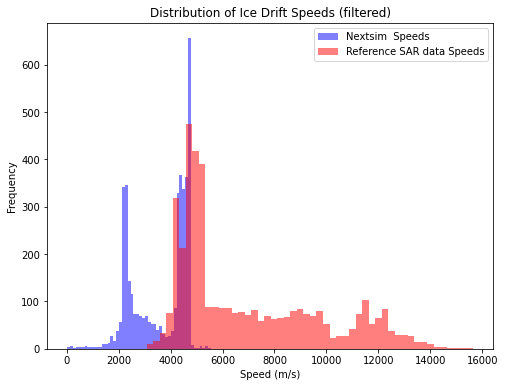

Reference Speeds:
Mean speed: 6932.7848 m/s
Min speed: 3080.6269 m/s
Max speed: 15655.2723 m/s
95th percentile speed: 12337.5081 m/s

Model Speeds:
Mean speed: 6932.7848 m/s
Min speed: 3080.6269 m/s
Max speed: 15655.2723 m/s
95th percentile speed: 12337.5081 m/s


In [235]:
speed_model_b = np.sqrt(( upm[gpi]**2+ vpm[gpi]**2)) 
speed_model_n = np.sqrt((int_dx[-1][gpi]**2+int_dx[-1][gpi]**2))
#speed_model_b = np.sqrt(( upm**2+ vpm**2)) 
#speed_model_n = np.sqrt((int_dx[-1]**2+int_dx[-1]**2))

speed_model_b = speed_model_b.flatten()
speed_model_n = speed_model_n.flatten()


plt.figure(figsize=(8,6))




# Plotting Reference Speed
#speed_model_n_clipped = np.clip(speed_model_n, 1000, 60000)
plt.hist(speed_model_n, bins=50, color='blue', alpha=0.5, label='Nextsim  Speeds')


# Plotting Model Speed
plt.hist(speed_model_b, bins=50, color='red', alpha=0.5, label= 'Reference SAR data Speeds')

plt.xlabel('Speed (m/s)')
plt.ylabel('Frequency')
plt.title('Distribution of Ice Drift Speeds (filtered)')
plt.legend()
plt.show()

# Print statistics for reference speeds
percentile_95_ref = np.percentile(speed_model_b, 95)
mean_speed_ref = np.nanmean(speed_model_b)
min_speed_ref = np.nanmin(speed_model_b)
max_speed_ref = np.nanmax(speed_model_b)

print(f"Reference Speeds:")
print(f"Mean speed: {mean_speed_ref:.4f} m/s")
print(f"Min speed: {min_speed_ref:.4f} m/s")
print(f"Max speed: {max_speed_ref:.4f} m/s")
print(f"95th percentile speed: {percentile_95_ref:.4f} m/s")

# Print statistics for model speeds
percentile_95_model = np.percentile(speed_model_b, 95)
mean_speed_model = np.nanmean(speed_model_b)
min_speed_model = np.nanmin(speed_model_b)
max_speed_model = np.nanmax(speed_model_b)

print("\nModel Speeds:")
print(f"Mean speed: {mean_speed_model:.4f} m/s")
print(f"Min speed: {min_speed_model:.4f} m/s")
print(f"Max speed: {max_speed_model:.4f} m/s")
print(f"95th percentile speed: {percentile_95_model:.4f} m/s")


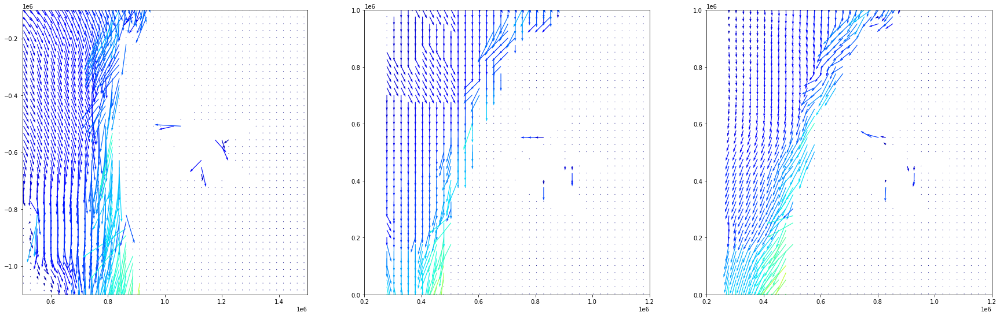

In [7]:
# JUST FOR COMPARISON WITH ANOTHER GRID

with Dataset('/data1/antonk/tmp/Moorings_barents.nc') as ds:
    n_u = ds['siu'][23]
    n_v = ds['siv'][23]

with Dataset('/data1/antonk/tmp/Moorings_2022d305.nc') as ds:
    t_u = ds['siu'][47]
    t_v = ds['siv'][47]

with Dataset('/Data/sim/data/nextsim_output_grids/topaz6_grid.nc') as ds:
    t_x = ds['x'][:] * 100000
    t_y = ds['y'][:] * 100000

b_u, b_v = correct_vectors(n_u, n_v, lon0, lat0, b_x, b_y)    
    
fig, axs = plt.subplots(1,3,figsize=(30,10))
step = 8
#axs[0].pcolormesh(m1x[::step], m1y[::step], , cmap='jet', vmin=0, vmax=0.1)
axs[0].quiver(t_x[::step], t_y[::step], t_u[::step, ::step], t_v[::step, ::step], np.hypot(t_u[::step, ::step], t_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000001, cmap='jet', clim=[0, 0.5])
axs[0].set_xlim([0.5e6,1.5e6])
axs[0].set_ylim([-1.1e6,-0.1e6])
axs[0].set_aspect('equal')

step = 10
#axs[1].pcolormesh(m2x[::step], m2y[::step],  cmap='jet', vmin=0, vmax=0.1)
axs[1].quiver(b_x[::step], b_y[::step], n_u[::step, ::step], n_v[::step, ::step], np.hypot(n_u[::step, ::step], n_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000002, cmap='jet', clim=[0, 0.5])
axs[1].set_xlim([0.2e6,1.2e6])
axs[1].set_ylim([0,1e6])
axs[1].set_aspect('equal')

#axs[2].pcolormesh(m2x[::step], m2y[::step], cmap='jet', vmin=0, vmax=0.1)
axs[2].quiver(b_x[::step], b_y[::step], b_u[::step, ::step], b_v[::step, ::step], np.hypot(b_u[::step, ::step], b_v[::step, ::step]), angles='xy', scale_units='xy', scale=0.000002, cmap='jet', clim=[0, 0.5])
axs[2].set_xlim([0.2e6,1.2e6])
axs[2].set_ylim([0,1e6])
axs[2].set_aspect('equal')

plt.show()